# Catch Basin EDA
---

In [17]:
import geopandas as gpd
import plotly.express as px
import numpy as np
import pyproj

import warnings
warnings.filterwarnings('ignore')

## Load Data
---

In [11]:
data = '/workspace/data/DEPCatchbasins/'

In [12]:
data_gpd = gpd.read_file(data)

## Initial Exploration
---

In [13]:
data_gpd.head()

,UNITID,LATITUDE,LONGITUDE,POINT_X,POINT_Y,geometry
0,CB550115,40.518700,-74.194200,930230.623100,128315.947500,POINT (930230.623 128315.948)
1,CB550005,40.518580,-74.194200,930232.445300,128271.111900,POINT (930232.445 128271.112)
2,CB550061,40.518062,-74.195963,929765.086058,128081.621106,POINT (929765.086 128081.621)
3,CB550062,40.517990,-74.195894,929784.007040,128055.367355,POINT (929784.007 128055.367)
4,CB550064,40.518575,-74.196172,929707.412976,128268.675615,POINT (929707.413 128268.676)


In [15]:
data_gpd.crs

<Derived Projected CRS: EPSG:2263>
Name: NAD83 / New York Long Island (ftUS)
Axis Info [cartesian]:
- X[east]: Easting (US survey foot)
- Y[north]: Northing (US survey foot)
Area of Use:
- name: United States (USA) - New York - counties of Bronx; Kings; Nassau; New York; Queens; Richmond; Suffolk.
- bounds: (-74.26, 40.47, -71.8, 41.3)
Coordinate Operation:
- name: SPCS83 New York Long Island zone (US Survey feet)
- method: Lambert Conic Conformal (2SP)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [20]:
data_gpd.isnull().values.any()

False

## Visualization
---

In [21]:
# # Get the centroid of the geodata
# data_gpd['x'] = data_gpd.centroid.x
# data_gpd['y'] = data_gpd.centroid.y

# # Convert into Degrees
# inProj  = pyproj.Proj("+init=EPSG:2263",preserve_units=True)
# outProj = pyproj.Proj("+init=EPSG:4326")

# # Convert Coords
# x_coord, y_coord = pyproj.transform(inProj,outProj,data_gpd['x'], data_gpd['y'])
# data_gpd['Latitude'] = y_coord
# data_gpd['Longitude'] = x_coord

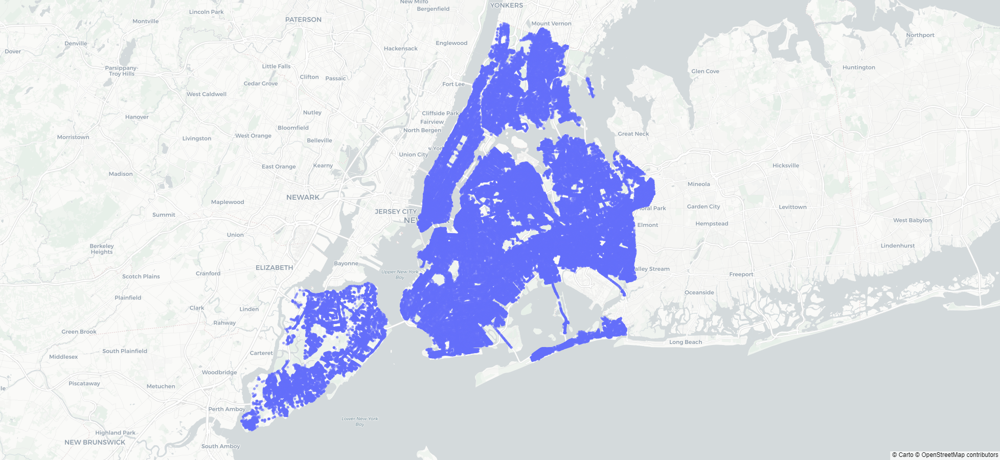

In [19]:
#Scatter Map
fig = px.scatter_mapbox(data_gpd,
                        lat="Latitude",
                        lon="Longitude",
                        hover_name="UNITID",
                        hover_data=["UNITID"],
                        zoom=10,
                        height=900,
                        size_max=12,
                        opacity=0.4,
                        width=1300)
fig.update_layout(mapbox_style='carto-positron')
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_layout(title_text="Catch Basin Locations in New York")
fig.show()